# **Exploring brain artery trees and age with gioto-tda**


## **Overview of the task**
In this analysis we will explore the point clouds of brain artery trees, extract topological features and train a classifier to distinguish between 2 age groups: group 0 with people younger than 45, and group 1 with people older than 45. The reasonable baseline that we will use would be a geometric measurement of total brain artery length, gender and handedness. It has been suggested in [this paper](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5026243/) and in [this blogpost](https://towardsdatascience.com/persistent-homology-with-examples-1974d4b9c3d0) that topological features can help in identifying the age of a person's brain, with younger people having significantly longer total artery length and more loops in it. giotto-tda plays the essential place in this analysis for plotting, calculating persistent diagrams and transforming them into feature vectors for the ML system. 


## **Introduction**

## **Dataset**
The dataset can be found [here](https://gitlab.com/alexpieloch/PersistentHomologyAnalysisofBrainArteryTrees/-/tree/master/data/OriginalBrainTreeData). There are 98 trees which are the result of applying a [tube-tracking algorithm](http://citeseerx.ist.psu.edu/viewdoc/summary?doi=10.1.1.102.7885) to the magnetic resonance (MR) images of the brain. The consist of approx. 120 000 vertices in 3D each, branches and edges. For the purpose of this analysis, we have only used a point cloud of all the vertices for initial visualisation and we have randomly downsampled to 500 vertices per tree in order to comply with the computational limit, otherwise the notebook will run for more than 15 mins.






# **Packages**

In [27]:
# Install pip packages in the current Jupyter kernel
import sys
!{sys.executable} -m pip install numpy seaborn mpl_toolkits ast

import pandas as pd
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

import numpy as np
from ast import literal_eval


from gtda.plotting  import plot_point_cloud, plot_diagram
from gtda.diagrams import NumberOfPoints
from gtda.pipeline import Pipeline
from gtda.diagrams import Amplitude

import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier

# **Load dataset**

The dataset has been pre-processed in another notebook from the .mat files to .csv files.

In [28]:
# Read the dataset
df = pd.read_csv('subsampled_data_500_final.csv', converters={'subsampled_point_cloud_500': eval})
df_vis = pd.read_csv('visualisation_data.csv', converters={'vertices_coordinates': eval})

In [29]:
df

,subject,subsampled_point_cloud_500,total_artery_length,age,gender,hand,label
0,1,"[[112.653312597, 104.036524485, 54.9634287042]...",6925.358945,54,1,1,1
1,2,"[[116.634675312, 156.61412840100002, 63.936879...",6286.157836,25,2,1,0
2,3,"[[84.44288064, 76.104351534, 79.71928000000001...",7100.591603,20,1,1,0
3,4,"[[113.118446655, 43.5538491729, 62.53664000000...",6424.308916,27,1,1,0
4,5,"[[51.665304555, 123.927422877, 20.413520000000...",8710.597656,24,1,1,0
...,...,...,...,...,...,...,...
93,105,"[[90.662123442, 123.682534416, 101.73174567000...",5171.655045,79,2,1,1
94,106,"[[88.274332599, 91.275628077, 101.595619015], ...",4787.769584,63,2,2,1
95,107,"[[90.206230458, 128.73740189400002, 93.0642326...",4452.018480,68,2,1,1
96,108,"[[86.88714471300001, 160.08107133, 98.67513658...",6241.203997,58,2,1,1


In [30]:
df_vis

,subject,vertices_coordinates,total_artery_length,age,gender,hand,label
0,3,"[[109.48619117999999, 87.998127165, 14.4936], ...",7100.591603,20,1,1,0
1,105,"[[86.127836466, 88.388819238, 40.5228586925999...",5171.655045,79,2,1,1


In [31]:
y = df['label'].to_list()

# **Visualisation and data exploration**

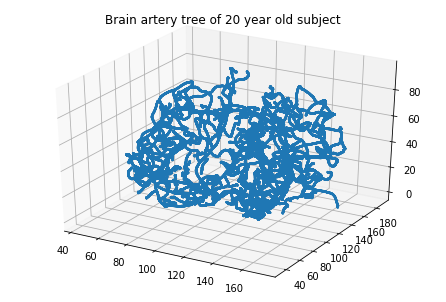

In [32]:
fig = pyplot.figure()
ax = Axes3D(fig)
coordinates = np.asarray(df_vis['vertices_coordinates'].iloc[0])
ax.scatter(coordinates[:,0], coordinates[:,1], coordinates[:,2], 'ko', s=2)
pyplot.title('Brain artery tree of 20 year old subject')
pyplot.show()

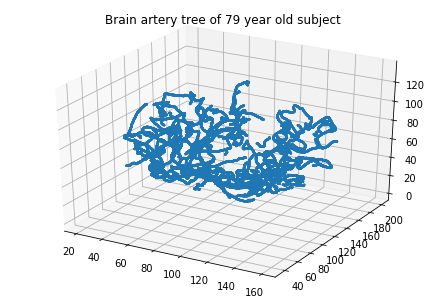

In [33]:
fig = pyplot.figure()
ax = Axes3D(fig)
coordinates = np.asarray(df_vis['vertices_coordinates'].iloc[1])
ax.scatter(coordinates[:,0], coordinates[:,1], coordinates[:,2], 'ko', s=2)
pyplot.title('Brain artery tree of 79 year old subject')
pyplot.show()

Number of subjects under 45 (Group 0):  51
Number of subjects over 45 (Group 1) :  47
Proportion of Group 0 :  0.5204081632653061
Proportion of Group 1 :  0.47959183673469385


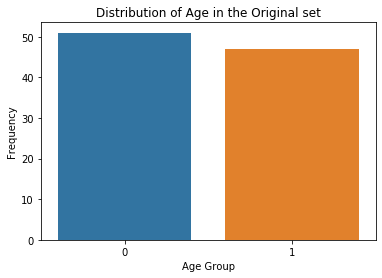

In [34]:
# explore labels

ax = sns.countplot(df["label"], label="Count")
B, M = df["label"].value_counts()
plt.title('Distribution of Age in the Original set')
plt.xlabel('Age Group')
plt.ylabel('Frequency')

print('Number of subjects under 45 (Group 0): ',B)
print('Number of subjects over 45 (Group 1) : ',M)
print('Proportion of Group 0 : ',B/(M+B))
print('Proportion of Group 1 : ',M/(M+B))

We have a well-balanced dataset with almost 50-50 split between the 2 age groups. Next, we proceed to plot the brain artery trees of 2 subjects belonging to each group, one is 20 and the other is 79-years-old. We plot all the approx. 120k vertices for illustration purpose so that one can develop an intuition about the loopy structure of the brain arteries, and how they might defer as the brain ages.

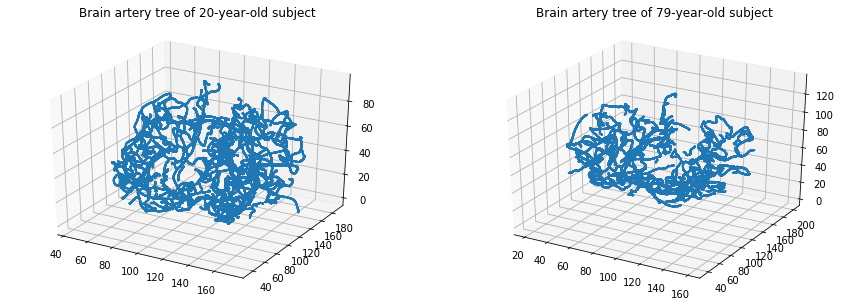

In [35]:
# set up a figure twice as wide as it is tall
fig = plt.figure(figsize=(15,5))


#===============
#  First subplot
#===============
# set up the axes for the first plot
coordinates_group0 = np.asarray(df_vis['vertices_coordinates'].iloc[0])
ax = fig.add_subplot(1, 2, 1, projection='3d')
ax.title.set_text('Brain artery tree of 20-year-old subject')
ax.scatter(coordinates_group0[:,0], coordinates_group0[:,1], coordinates_group0[:,2], 'ko', s=1)


#===============
# Second subplot
#===============
# set up the axes for the second plot
coordinates_group1 = np.asarray(df_vis['vertices_coordinates'].iloc[1])
ax = fig.add_subplot(1, 2, 2, projection='3d')
ax.title.set_text('Brain artery tree of 79-year-old subject')
ax.scatter(coordinates_group1[:,0], coordinates_group1[:,1], coordinates_group1[:,2], 'ko', s=1)
plt.show()

In [36]:
plot_point_cloud(coordinates_group0)

In [37]:
plot_point_cloud(coordinates_group1)

After we have plotted the extreme cases with all the data points, we will use a downsampled version with 500 points.

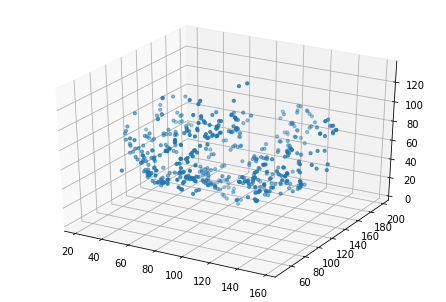

In [38]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

fig = pyplot.figure()
ax = Axes3D(fig)
example = np.asarray(df['subsampled_point_cloud_500'].iloc[93])
ax.scatter(example[:,0], example[:,1], example[:,2], 'ko', s=10)
pyplot.show()

In [39]:
plot_point_cloud(example)

In [40]:
# convert the pandas dataframe column into a 3D array for PH calculations
subsampled_point_cloud_500 = df['subsampled_point_cloud_500'].to_list()
X_array = np.array(subsampled_point_cloud_500)

In [41]:
X_array.shape

(98, 500, 3)

In [42]:
from gtda.homology import VietorisRipsPersistence
%time
homology_dimensions = [0,1]

persistence = VietorisRipsPersistence(
    metric="euclidean",
    homology_dimensions=homology_dimensions,
    n_jobs=6,
)
diagrams_basic = persistence.fit_transform(X_array)

Wall time: 0 ns


In [43]:
diagrams_basic.shape

(98, 648, 3)

In [44]:
# Exampl PH diagrams for 20-year-old subject
plot_diagram(diagrams_basic[2])

In [45]:
#Brain artery tree of 79-year-old subject
plot_diagram(diagrams_basic[93])

We can see that there are more points further away from the diagonal in the case of the younger brain. This signifies the fact that there are more loops and the structure of the arteries is loopier than that of the older brain.

In [46]:
from gtda.diagrams import PersistenceEntropy

persistence_entropy = PersistenceEntropy()

# calculate topological feature matrix
X_basic = persistence_entropy.fit_transform(diagrams_basic)

# expect shape - (n_point_clouds, n_homology_dims)
X_basic.shape

(98, 2)

In [47]:
plot_point_cloud(X_basic)

# **Machine learning**

In [48]:
from sklearn.pipeline import make_union

# Select a variety of metrics to calculate amplitudes
metrics = [
    {"metric": metric}
    for metric in ["bottleneck", "wasserstein", "landscape", "persistence_image"]
]

# Concatenate to generate 3 + 3 + (4 x 3) = 18 topological features
feature_union = make_union(
    PersistenceEntropy(normalize=True),
    NumberOfPoints(n_jobs=-1),
    *[Amplitude(**metric, n_jobs=-1) for metric in metrics]
)

In [49]:
pipe = Pipeline(
    [
        ("features", feature_union),
        ("rf", RandomForestClassifier(oob_score=True, random_state=42)),
    ]
)
pipe.fit(diagrams_basic, y)
pipe["rf"].oob_score_

0.7346938775510204

# **Comparison with a reasonable benchmark**

In [50]:
# train a baseline classifier with the total artery length, gender and hand attributes.
y = df['label'].to_list()
rf = RandomForestClassifier(oob_score=True, random_state=42)

df_ml = df[['total_artery_length', 'gender','hand']].copy()
rf.fit(df_ml, y)

print(f"OOB score: {rf.oob_score_:.3f}")

OOB score: 0.714


We note a 2% increase in performance in the topological features comared to the geometric.
However, it should be noted that the original dataset contained more than 120K points. The choice to downsample was for computational reasons so that the code can run in less than 15 mins. Attempts with 3000, 2000, 1000 points were made, but the time it took was substantially longer. The results are expected to be better when we have more datapoints.

We can also add more topological features, try other classifiers and perform hyperparameter tuning, and use techniques such as boosting to improve the performance.

# **Conclusion**

In this notebook we have obtained interesting results regarding the relathionship between brain artery trees and age. The topological features slightly outperform the geometic measurement of total brain artery length in the age classification task. However, we are only using a small subsample of 500 the available vertices. It would be interesting to see if adding more points to the point clouds would change the accuracy. Unfortunately, that is related to longer run times.

We have only considered healthy individuals. In future work it would be of interest to develop topological techniques for detecting brain abnormalities linked to various brain diseases. giotto-tda played the central role in this analysis, and it could be used to further add more topological features and for useful interpretations of linking biological biomarkers with the topology of the brain arteries.